In [1]:
from skimage import io, morphology, color, util, filters, draw
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="darkgrid", palette="Set2")

data = "data/"

In [2]:
img  = io.imread(data + '0_fluorescence.jpg')
img_true  = io.imread(data + '0_brightfield.jpg')

img.shape

(5733, 3893, 3)

In [3]:
#img_gray = color.rgb2gray(img)
img_gray = img[:,:,2]

img_gray = util.img_as_ubyte(img_gray)
img_gray

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

(-0.5, 3892.5, 5732.5, -0.5)

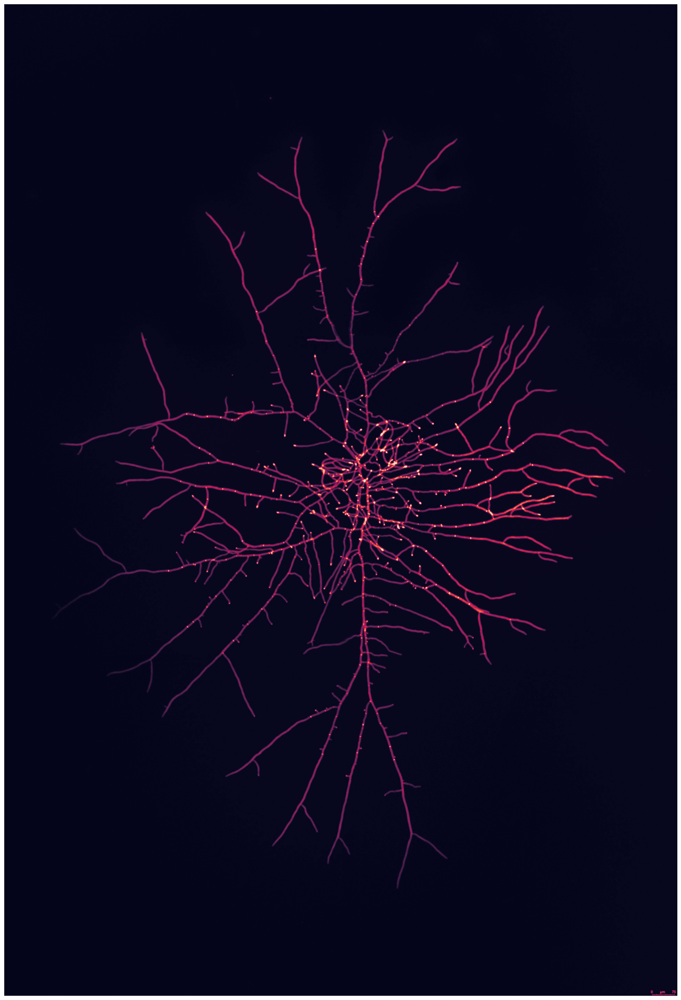

In [44]:
plt.figure(figsize=[40,30])
plt.imshow(img_gray)
plt.axis('off')

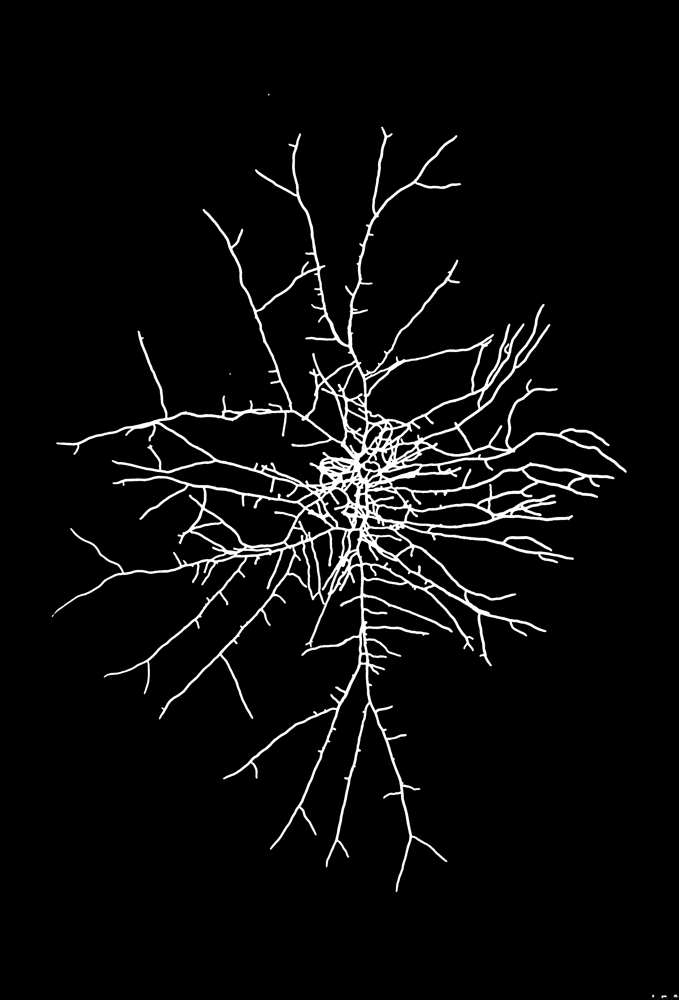

In [5]:
threshold = 14

img_binarized = img_gray.copy()
img_binarized[img_binarized >= threshold] = 255
img_binarized[img_binarized < threshold] = 0

img_binarized = img_binarized.astype(np.bool)

img_binarized = filters.median(img_binarized, selem=morphology.square(5))

#plt.figure(figsize=[15,15])
#plt.imshow(img_binarized)

Image.fromarray(img_binarized)

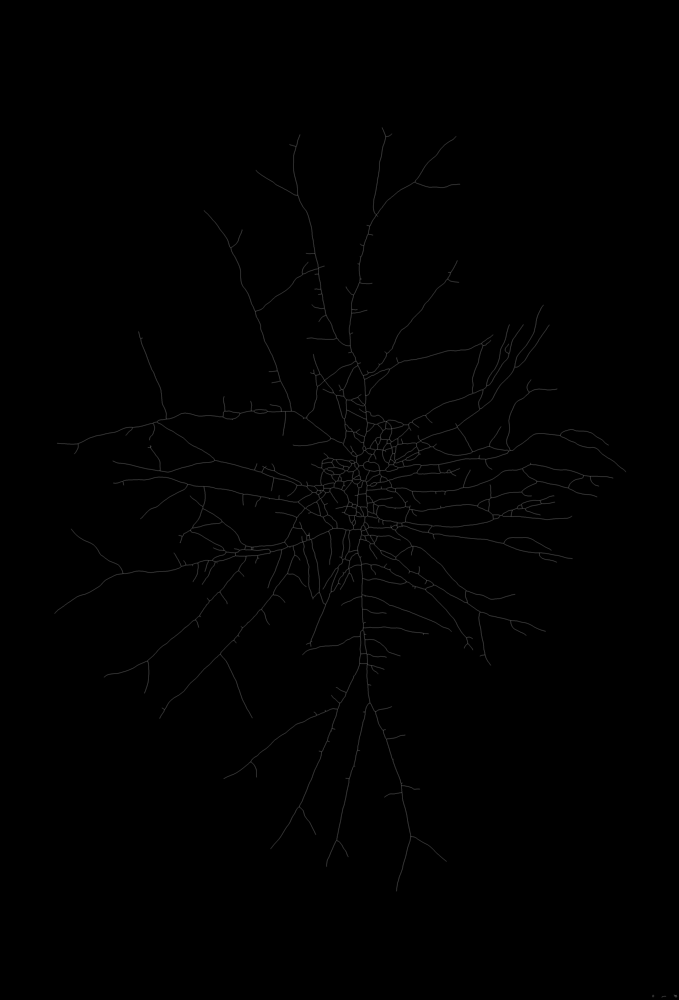

In [6]:
skeleton = morphology.skeletonize(img_binarized)
skeleton = morphology.remove_small_objects(skeleton, min_size=20, connectivity=2)


Image.fromarray(skeleton)


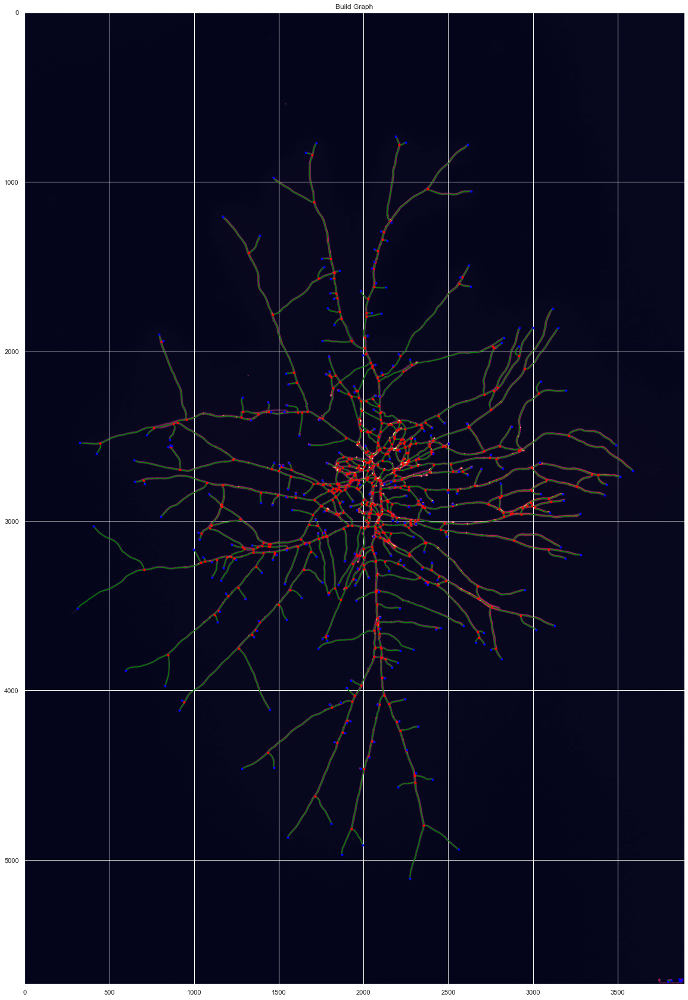

In [7]:
import sknw

# build graph from skeleton
graph = sknw.build_sknw(skeleton)

plt.figure(figsize=[30,30])

# draw image
plt.imshow(img_gray)

# draw edges by pts
for (s,e) in graph.edges():
    current_ps = graph[s][e]['pts']
    plt.plot(current_ps[:,1], current_ps[:,0], 'green')
    
# draw node by o
nodes = graph.nodes()
bs = np.array([nodes[i]['o'] for i in nodes if len(graph.edges(i))>=3])
ts = np.array([nodes[i]['o'] for i in nodes if len(graph.edges(i))<=2])
plt.plot(bs[:,1], bs[:,0], 'r.')
plt.plot(ts[:,1], ts[:,0], 'b.')

# title and show
plt.title('Build Graph')
plt.show()

# Calculate curvature

In [8]:
def calculate_radius(p1, p2, p3):
    temp = p2[0] * p2[0] + p2[1] * p2[1]
    bc = (p1[0] * p1[0] + p1[1] * p1[1] - temp) / 2
    cd = (temp - p3[0] * p3[0] - p3[1] * p3[1]) / 2
    det = (p1[0] - p2[0]) * (p2[1] - p3[1]) - (p2[0] - p3[0]) * (p1[1] - p2[1])

    if abs(det) < 1.0e-6:
        return None

    # Center of circle
    cx = (bc*(p2[1] - p3[1]) - cd*(p1[1] - p2[1])) / det
    cy = ((p1[0] - p2[0]) * cd - (p2[0] - p3[0]) * bc) / det

    radius = np.sqrt((cx - p1[0])**2 + (cy - p1[1])**2)
    return radius

def calculate_curvatures(points, dist=30):

    curvatures = list()
    
    for i in range(dist, len(points[:,0])-dist):

        xm1, x, xp1 = points[i-dist,0], points[i,0], points[i+dist,0]
        ym1, y, yp1 = points[i-dist,1], points[i,1], points[i+dist,1]

        r = calculate_radius((xm1, ym1), (x,y), (xp1, yp1))
        if r is not None:
            curvatures.append(1/r)
        else:
            curvatures.append(0)
    
    if len(curvatures) != 0:
        return curvatures
    else:
        return [0]

In [9]:
ps = list()

for (s,e) in graph.edges():
    ps.append(graph[s][e]['pts'].astype(np.int32))

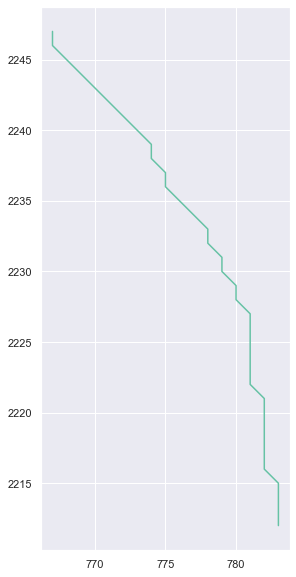

In [10]:
f, ax = plt.subplots(1,1, figsize=[10,10])

plt.plot(ps[1][:,0], ps[1][:,1])

ax.set_aspect('equal')

In [11]:
curvatures = list()

for i in range(len(ps)):
    
    curvatures.extend(calculate_curvatures(ps[i]))

C:\Users\Niels\.conda\envs\echelon\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

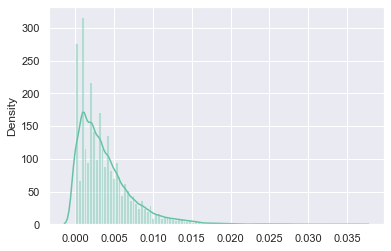

In [12]:
sns.distplot(curvatures, bins=100)

# Branching frequency

In [13]:
bf = (len(bs))/graph.size(weight="weight")
print(f"branch occurence per pixel is {bf}")

pixels_per_hyphal_element = 50
print(f"branch occurence per hyphal element is {bf*pixels_per_hyphal_element}")

n_hyphal_elements = (graph.size(weight="weight"))/pixels_per_hyphal_element
print(f"the number of hyphal elements is approximately {n_hyphal_elements}")

n_hours = 24
print(f"branch frequency per hyphal element per hour is {bf*pixels_per_hyphal_element/24}")

branch occurence per pixel is 0.007525730893404191
branch occurence per hyphal element is 0.37628654467020956
the number of hyphal elements is approximately 1451.0218548434495
branch frequency per hyphal element per hour is 0.0156786060279254


# Make tip and branch mask from network coordinate

In [14]:
branch_mask = np.zeros(skeleton.shape, dtype=np.bool)

radius = 18
selem = morphology.disk(radius)
dims = skeleton.shape

for x,y in bs:
    x,y = int(x), int(y)
    
    # for edge cases, don't use selem, just square
    if dims[0] - x < radius + 1 or dims[1] - y < radius + 1:
        branch_mask[x-radius:x+radius+1, y-radius:y+radius+1] = True
    else:
        # use binary or to avoid overwriting with 0's
        branch_mask[x-radius:x+radius+1, y-radius:y+radius+1] = branch_mask[x-radius:x+radius+1, y-radius:y+radius+1] | selem
    
branch_mask = branch_mask & img_binarized

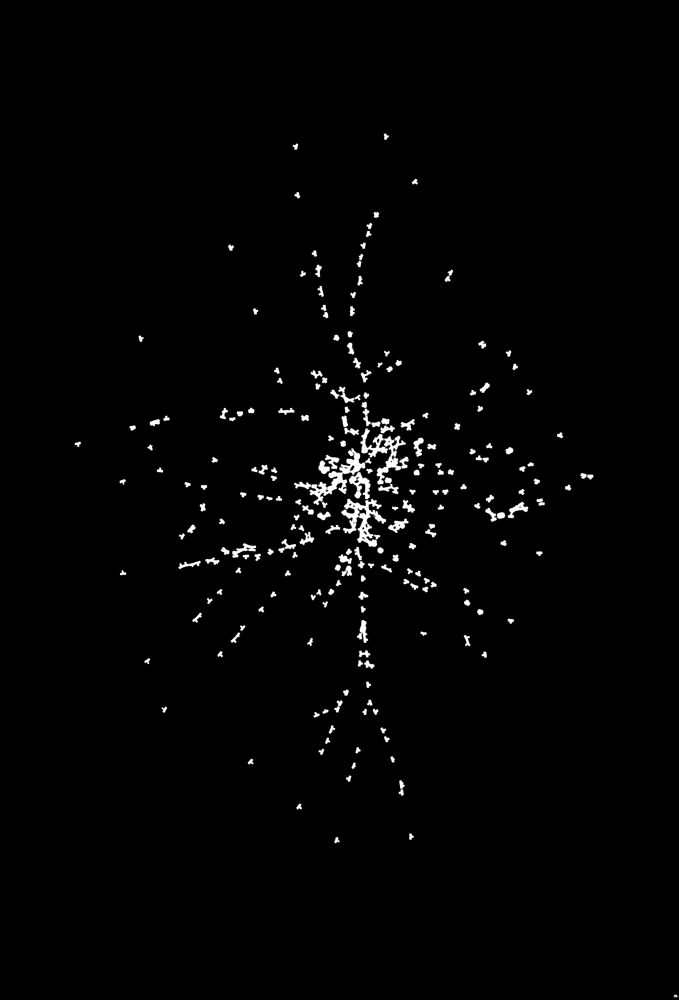

In [15]:
Image.fromarray(branch_mask & img_binarized)

In [16]:
tip_mask = np.zeros(skeleton.shape, dtype=np.bool)

radius = 9
selem = morphology.disk(radius)
dims = skeleton.shape

for x,y in ts:
    x,y = int(x), int(y)
    
    # for edge cases, don't use selem, just square
    if dims[0] - x < radius + 1 or dims[1] - y < radius + 1:
        tip_mask[x-radius:x+radius+1, y-radius:y+radius+1] = True
    else:
        # use binary or to avoid overwriting with 0's
        tip_mask[x-radius:x+radius+1, y-radius:y+radius+1] = tip_mask[x-radius:x+radius+1, y-radius:y+radius+1] | selem
    
tip_mask = tip_mask & img_binarized

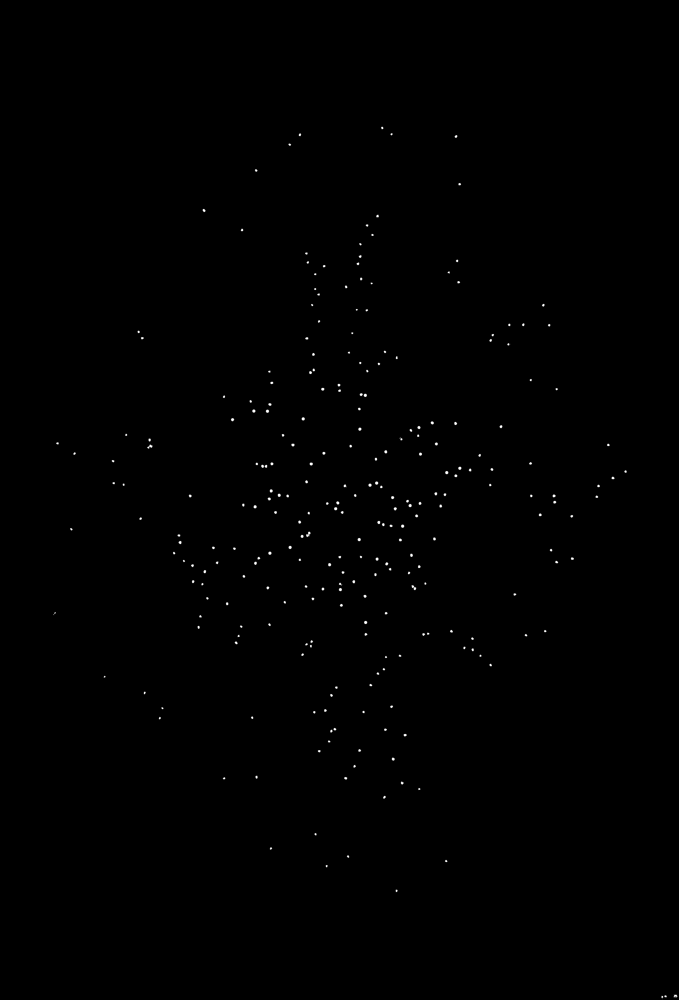

In [17]:
Image.fromarray(tip_mask & img_binarized)

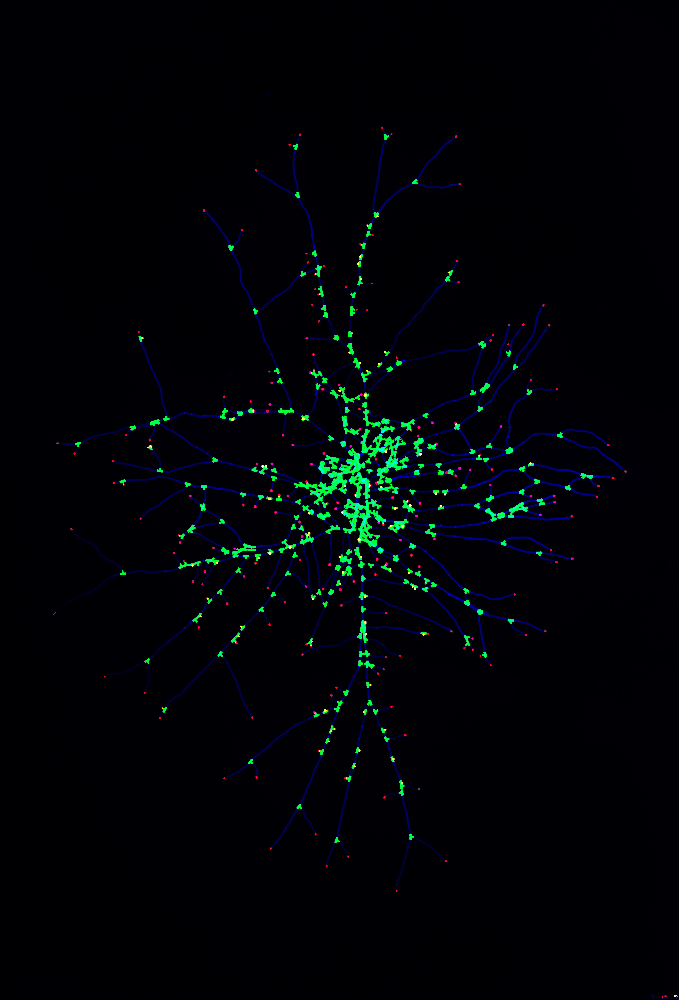

In [18]:
tip_mask = (tip_mask*255).astype(np.uint8)
branch_mask = (branch_mask*255).astype(np.uint8)

final_mask = np.array([tip_mask, branch_mask, img_gray])

Image.fromarray(final_mask.swapaxes(0,2).swapaxes(0,1))

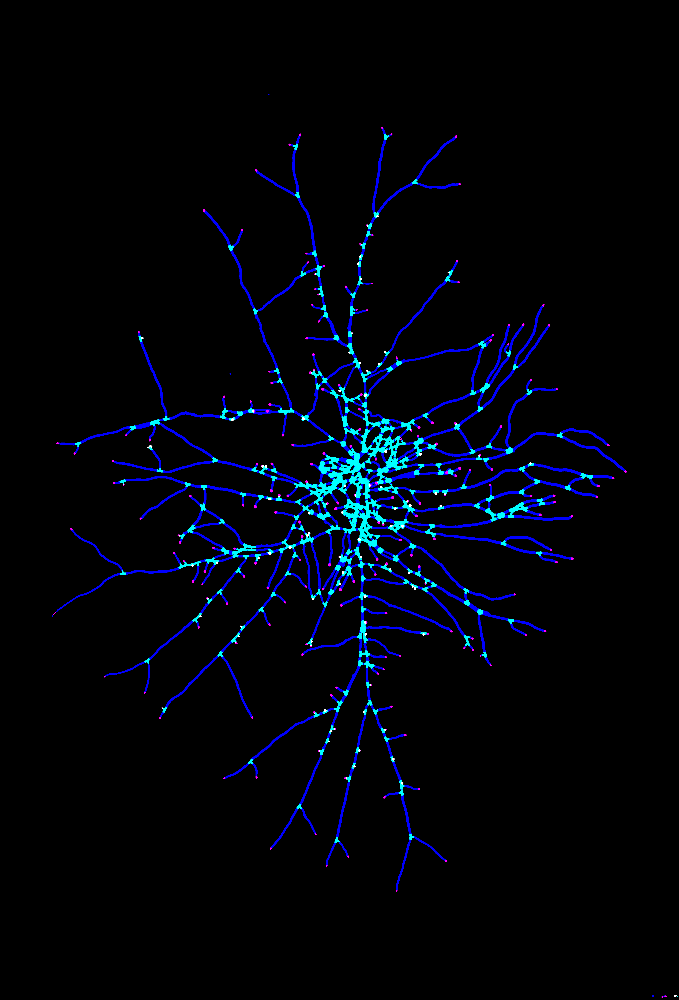

In [19]:
img_binarized_uint8 = (img_binarized*255).astype(np.uint8)

final_mask_2 = np.array([tip_mask, branch_mask, img_binarized_uint8])

final_mask_2 = final_mask_2.swapaxes(0,2).swapaxes(0,1)

Image.fromarray(final_mask_2)

In [20]:
io.imsave(data+"1_segmentation_target.jpg", final_mask_2)

In [21]:
import skimage
morphology.disk(6).shape

(13, 13)

In [22]:
img_true_gray = (color.rgb2gray(img_true)*255).astype(np.uint8)

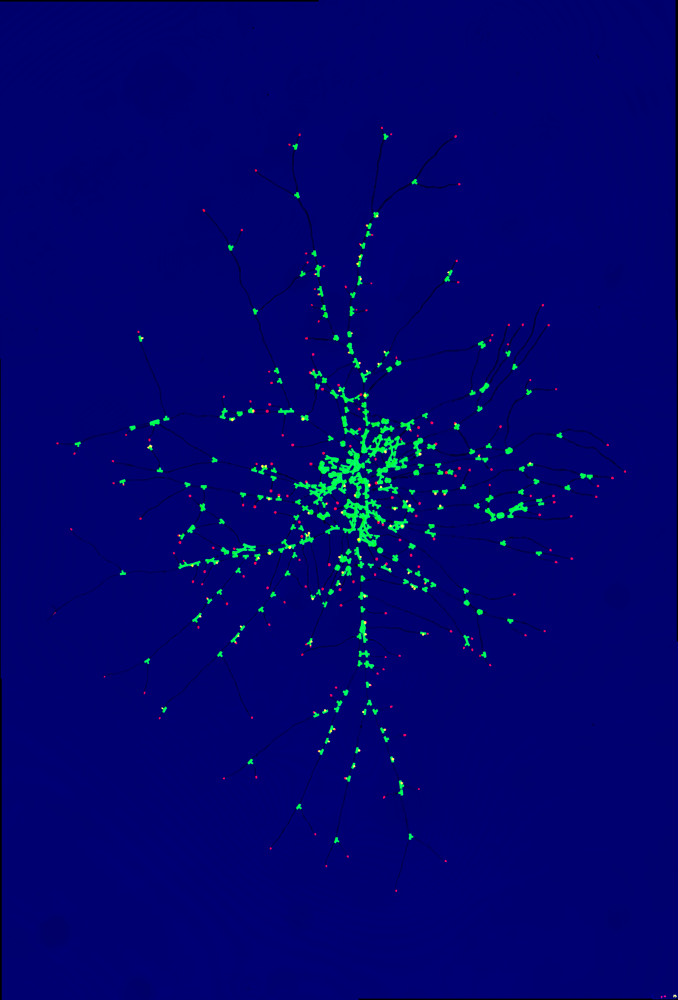

In [23]:
final_mask_3 = np.array([tip_mask[:, :-2], branch_mask[:, :-2], img_true_gray])

final_mask_3 = final_mask_3.swapaxes(0,2).swapaxes(0,1)

Image.fromarray(final_mask_3)

In [24]:
final_mask_3.dtype

dtype('uint8')

In [25]:
branch_mask.shape

(5733, 3893)

In [26]:
color.rgb2gray(img_true)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])